# Heam Trajectory

In [1]:
import sys
import subprocess

#import pkg_resources
#required = {'harmonypy','sklearn','scanpy','pandas', 'numpy', 'bbknn', 'scipy', 'matplotlib', 'seaborn' ,'scipy'}
#installed = {pkg.key for pkg in pkg_resources.working_set}
#missing = required - installed
#if missing:
#    print("Installing missing packages:" )
#    print(missing)
#    python = sys.executable
#    subprocess.check_call([python, '-m', 'pip', 'install', *missing], stdout=subprocess.DEVNULL)

%matplotlib inline
from collections import Counter
from collections import defaultdict
import scanpy as sc
import pandas as pd
import pickle as pkl
import numpy as np
from bbknn import bbknn
import scipy
import matplotlib.pyplot as plt
import re
import glob
import os
import sys
from geosketch import gs
from numpy import cov
import scipy.cluster.hierarchy as spc
import seaborn as sns; sns.set(color_codes=True)
from sklearn.linear_model import LogisticRegression
import sklearn
import harmonypy as hm
from pathlib import Path

sc.settings.verbosity = 3  # verbosity: errors (0), warnings (1), info (2), hints (3)
sc.settings.set_figure_params(dpi=80, color_map='viridis')
plt.rcParams['figure.figsize'] = [15, 15]

In [2]:
col_pal = [
    '#ff0000',
    '#94BFB1',
    '#B49EC8',
    '#E0EE70',
    '#EE943E',
    '#4C7BAB',
    '#E78AB8',
    '#AFBFCC',
    '#814F75',
    "#FFFF00", "#1CE6FF", "#FF34FF", "#FF4A46", "#008941", "#006FA6", "#A30059",
    "#FFDBE5", "#7A4900", "#0000A6", "#63FFAC", "#B79762", "#004D43", "#8FB0FF", "#997D87",
    "#5A0007", "#809693", "#6A3A4C", "#1B4400", "#4FC601", "#3B5DFF"
]

In [3]:
run_name = 'YS_fliv_progen_trajectory_with_HE_290921'
save_loc = '/nfs/team205/ig7/work_backups/backup_210306/projects/YS/YS_090321_notebooks/YS_Reprocess_250721_updates/FDG_FIG2/'
Object = '/nfs/team205/ig7/work_backups/backup_210306/projects/YS/YS_data/A4_V7_Combined_YS_Fliver_20210914.h5ad'



save_path = "/nfs/team205/ig7/work_backups/backup_210306/projects/YS/YS_090321_notebooks/YS_Reprocess_250721_updates/LR_YS_LIV"

# Required: Name of first object
data2 = "_ys"
# Provide categorical to join between datasets
cat2 = "cell.labels"

# Required: Name of second object
data1 = "_fliv"
# Provide categorical to join between datasets
cat1 = "cell.labels"

In [11]:
import os
if not os.path.exists(save_loc):
    os.makedirs(save_loc)
adata = sc.read(Object)
adata.obs.columns

Index(['cell.labels', 'stage', 'lanes', 'sex', 'sort.ids', 'fetal.ids',
       'component', 'broad_cell.labels', 'sequencing.type', 'orig.dataset',
       'broad_cell_labels_organ', 'tissue', 'tissue_fetal_id'],
      dtype='object')

# Update adata metadata

In [12]:
obs = pd.read_csv('/nfs/team205/ig7/work_backups/backup_210306/projects/YS/YS_090321_notebooks/YS_Reprocess_250721_updates/Combined_YS_Fliver_meta_20210929.csv',index_col=0)
adata.obs = obs

In [13]:
list(adata.obs['cell.labels'].unique())

['Sinusoidal_EC',
 'MEMP',
 'HSPC_1',
 'Erythroid',
 'Endoderm',
 'Immature_EC',
 'Macrophage',
 'MK',
 'Early_Erythroid',
 'Lymphoid_progenitor',
 'Mesothelium',
 'Prolif_Sinusoidal_EC',
 'Fibroblast',
 'HSPC_2',
 'AEC',
 'Mast_cell',
 'MOP',
 'DC2',
 'CMP',
 'DC_precursor',
 'HE',
 'Monocyte',
 'LMPP',
 'Neutrophil_precursor',
 'Microglia',
 'Smooth_Muscle',
 'Promonocyte',
 'Eo_Baso_Mast_precursor',
 'ILC_precursor',
 'Pre_Macrophage',
 'VWF_EC',
 'Eo_Basophil',
 'Prolif_AEC',
 'NK',
 'Monocyte_Macrophage',
 'MPP',
 'Kupffer_cell_1',
 'Kupffer_cell_2',
 'Hepatocyte',
 'Endothelium',
 'MLP',
 'DC3',
 'HSC',
 'Promyelocyte',
 'DC1',
 'Pre_pro_B_progenitor',
 'Embryonic_Erythroid',
 'ELP',
 'Pre_DC2',
 'pDC',
 'MPP2',
 'ETP',
 'Pre_B',
 'Immature_B_cell',
 'Pre_pDC',
 'Pro_B_progenitor',
 'Pre_ILC_precursor']

In [14]:
common_cat = "corr_concat" 
adata.obs[common_cat] = "corr_concat"
adata.obs.loc[adata.obs['tissue'].isin(['YS']),common_cat] = adata.obs.loc[adata.obs['tissue'].isin(['YS']),cat1].astype(str) + data2
adata.obs.loc[adata.obs['tissue'].isin(['Liver']),common_cat] = adata.obs.loc[adata.obs['tissue'].isin(['Liver']),cat2].astype(str) + data1

# Mod both data manually

In [15]:
adata.obs.columns

Index(['cell.labels', 'stage', 'lanes', 'sex', 'sort.ids', 'fetal.ids',
       'component', 'broad_cell.labels', 'sequencing.type', 'orig.dataset',
       'broad_cell_labels_organ', 'tissue', 'corr_concat'],
      dtype='object')

In [16]:
adata.obs["lr_batch"]  = adata.obs["tissue"].astype(str) + '_' +  adata.obs['fetal.ids'].astype(str)

In [17]:
list(adata.obs["lr_batch"].unique())

['YS_Wang_CS10',
 'YS_Wang_CS11',
 'YS_F32',
 'YS_F35',
 'YS_F37',
 'YS_F61',
 'YS_F79',
 'YS_F80',
 'Liver_F61',
 'Liver_F35',
 'Liver_F32']

# Get a subset made first

In [18]:
list(adata.obs[common_cat].unique())

['Sinusoidal_EC_ys',
 'MEMP_ys',
 'HSPC_1_ys',
 'Erythroid_ys',
 'Endoderm_ys',
 'Immature_EC_ys',
 'Macrophage_ys',
 'MK_ys',
 'Early_Erythroid_ys',
 'Lymphoid_progenitor_ys',
 'Mesothelium_ys',
 'Prolif_Sinusoidal_EC_ys',
 'Fibroblast_ys',
 'HSPC_2_ys',
 'AEC_ys',
 'Mast_cell_ys',
 'MOP_ys',
 'DC2_ys',
 'CMP_ys',
 'DC_precursor_ys',
 'HE_ys',
 'Monocyte_ys',
 'LMPP_ys',
 'Neutrophil_precursor_ys',
 'Microglia_ys',
 'Smooth_Muscle_ys',
 'Promonocyte_ys',
 'Eo_Baso_Mast_precursor_ys',
 'ILC_precursor_ys',
 'Pre_Macrophage_ys',
 'VWF_EC_ys',
 'Eo_Basophil_ys',
 'Prolif_AEC_ys',
 'NK_ys',
 'Monocyte_Macrophage_ys',
 'MPP_fliv',
 'Kupffer_cell_1_fliv',
 'Kupffer_cell_2_fliv',
 'Hepatocyte_fliv',
 'Endothelium_fliv',
 'Early_Erythroid_fliv',
 'MEMP_fliv',
 'MLP_fliv',
 'MK_fliv',
 'Erythroid_fliv',
 'DC3_fliv',
 'DC2_fliv',
 'Monocyte_fliv',
 'HSC_fliv',
 'Promyelocyte_fliv',
 'Mast_cell_fliv',
 'DC1_fliv',
 'CMP_fliv',
 'Pre_pro_B_progenitor_fliv',
 'Embryonic_Erythroid_fliv',
 'MOP_fliv'

In [19]:
keep_ys = ["HSPC_1",
"HSPC_2",
"CMP",
"MEMP",
"LMPP",
"Lymphoid_progenitor",
"MOP",]

keep_fliv = ["HSC",
"MPP",
"MPP2",
"CMP",
"MEMP",
"LMPP",
"MLP",
"ELP",
"ETP",
"MOP",
]
keep_ys = [s + data2 for s in keep_ys]
keep_fliv = [s + data1 for s in keep_fliv]
keep = keep_ys + keep_fliv

# find non-inersect
set(keep) ^ set(list(adata.obs.loc[adata.obs[common_cat].isin(keep),common_cat].unique()))

set()

In [20]:
adata = adata[adata.obs[common_cat].isin(keep)]

In [21]:
list(adata.obs[common_cat].unique())

['MEMP_ys',
 'HSPC_1_ys',
 'Lymphoid_progenitor_ys',
 'HSPC_2_ys',
 'MOP_ys',
 'CMP_ys',
 'LMPP_ys',
 'MPP_fliv',
 'MEMP_fliv',
 'MLP_fliv',
 'HSC_fliv',
 'CMP_fliv',
 'MOP_fliv',
 'ELP_fliv',
 'MPP2_fliv',
 'ETP_fliv',
 'LMPP_fliv']

# Keep only genes in intersect

In [22]:
keep = pd.read_csv('/nfs/team205/ig7/work_backups/backup_210306/projects/YS/resources/intersect_genes.csv',index_col=0)
keep = list(set(list(keep[keep.columns[0]].astype(str))) & set(adata.var.index))
adata = adata[:,keep]
adata

View of AnnData object with n_obs × n_vars = 8994 × 16849
    obs: 'cell.labels', 'stage', 'lanes', 'sex', 'sort.ids', 'fetal.ids', 'component', 'broad_cell.labels', 'sequencing.type', 'orig.dataset', 'broad_cell_labels_organ', 'tissue', 'corr_concat', 'lr_batch'
    var: 'n_cells-0', 'mt-0', 'total_counts-0', 'highly_variable-0', 'intersect-0', 'means-0', 'dispersions-0', 'dispersions_norm-0', 'gene.mean-1', 'gene.dispersion-1', 'gene.dispersion.scaled-1', 'highly_variable', 'means', 'dispersions', 'dispersions_norm'
    uns: 'cell.labels_colors', 'hvg', 'neighbors', 'pca', 'tissue_colors', 'umap'
    obsm: 'X_pca', 'X_pca_back', 'X_umap'
    varm: 'PCs'
    obsp: 'connectivities', 'distances'

In [23]:
adata.write(save_loc+run_name+'.h5ad')

/home/jovyan/my-conda-envs/workhorse/lib/python3.8/site-packages/anndata/_core/anndata.py:1220: FutureWarning: The `inplace` parameter in pandas.Categorical.reorder_categories is deprecated and will be removed in a future version. Removing unused categories will always return a new Categorical object.
  c.reorder_categories(natsorted(c.categories), inplace=True)
/home/jovyan/my-conda-envs/workhorse/lib/python3.8/site-packages/anndata/_core/anndata.py:1228: ImplicitModificationWarning: Initializing view as actual.
  warnings.warn(
Trying to set attribute `.obs` of view, copying.
... storing 'cell.labels' as categorical
/home/jovyan/my-conda-envs/workhorse/lib/python3.8/site-packages/anndata/_core/anndata.py:1220: FutureWarning: The `inplace` parameter in pandas.Categorical.reorder_categories is deprecated and will be removed in a future version. Removing unused categories will always return a new Categorical object.
  c.reorder_categories(natsorted(c.categories), inplace=True)
Trying to

In [24]:
adata.obs

,cell.labels,stage,lanes,sex,sort.ids,fetal.ids,component,broad_cell.labels,sequencing.type,orig.dataset,broad_cell_labels_organ,tissue,corr_concat,lr_batch
Wang_et_al_AAACCTGCACCTATCC_1,MEMP,CS10,Wang_CS10,Male,Total,Wang_CS10,Membrane,Progenitors,TBC,Wang_et_al_Cell_Stem Cell_2021,Progenitors_ys,YS,MEMP_ys,YS_Wang_CS10
Wang_et_al_AAACCTGCACTTAAGC_1,HSPC_1,CS10,Wang_CS10,Male,Total,Wang_CS10,Membrane,Progenitors,TBC,Wang_et_al_Cell_Stem Cell_2021,Progenitors_ys,YS,HSPC_1_ys,YS_Wang_CS10
Wang_et_al_AAAGATGGTTGGACCC_1,HSPC_1,CS10,Wang_CS10,Male,Total,Wang_CS10,Membrane,Progenitors,TBC,Wang_et_al_Cell_Stem Cell_2021,Progenitors_ys,YS,HSPC_1_ys,YS_Wang_CS10
Wang_et_al_AAAGTAGAGTGGTCCC_1,HSPC_1,CS10,Wang_CS10,Male,Total,Wang_CS10,Membrane,Progenitors,TBC,Wang_et_al_Cell_Stem Cell_2021,Progenitors_ys,YS,HSPC_1_ys,YS_Wang_CS10
Wang_et_al_AAATGCCTCTGACCTC_1,Lymphoid_progenitor,CS10,Wang_CS10,Male,Total,Wang_CS10,Membrane,Progenitors,TBC,Wang_et_al_Cell_Stem Cell_2021,Progenitors_ys,YS,Lymphoid_progenitor_ys,YS_Wang_CS10
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
F32_Liver_CD45-_FCAImmP7316895_TTGCGTCAGCTAAGAT,MEMP,F32,FCAImmP7316895,NaN,CD45-,F32,NaN,Progenitor,NaN,NaN,Progenitor_fliv,Liver,MEMP_fliv,Liver_F32
F32_Liver_CD45-_FCAImmP7316895_TTGCGTCGTAAGTTCC,MPP,F32,FCAImmP7316895,NaN,CD45-,F32,NaN,Progenitor,NaN,NaN,Progenitor_fliv,Liver,MPP_fliv,Liver_F32
F32_Liver_CD45-_FCAImmP7316895_TTTCCTCCACATGACT,MPP,F32,FCAImmP7316895,NaN,CD45-,F32,NaN,Progenitor,NaN,NaN,Progenitor_fliv,Liver,MPP_fliv,Liver_F32
F32_Liver_CD45-_FCAImmP7316895_TTTGCGCGTATCTGCA,HSC,F32,FCAImmP7316895,NaN,CD45-,F32,NaN,Progenitor,NaN,NaN,Progenitor_fliv,Liver,HSC_fliv,Liver_F32


# Update from cellxgene

In [25]:
#new_annotations = pd.read_csv('/nfs/team205/ig7/work_backups/backup_210306/projects/YS/YS_data/050821_YS_updates/progen_fraction/issac-cell-labels-UIMBBYYD.csv',
#                         comment='#',
#                         dtype='category',
#                         index_col=0)
#adata.obs = adata.obs.join(new_annotations)

In [26]:
#adata.obs['cell.labels_back_090921'] = adata.obs['cell.labels'][:]
#adata.obs['cell.labels'] = adata.obs['updates_090921']

In [27]:
#adata.obs['cell.labels_restricted_back_090921'] =  adata.obs['cell.labels_restricted'].copy()

In [28]:
#list(adata.obs['cell.labels'].unique())

In [29]:
#adata.obs = adata.obs.drop(['progen_fraction_ys_090821_leiden_progen_150',
#       'progen_fraction_ys_090821_leiden_progen_150_reassigned',
#       'progen_fraction_ys_120821_leiden_progen_150','cell.labels_15082 1_leiden_assigned1_leiden_assig','cell.labels_140821_leiden_assigned',
#       'cell.labels_15082 1_leiden_assigned1_leiden_assig','updates_090921'],axis=1)

In [30]:
#adata.obs.columns

# preprocess

In [31]:
# Only consider intersecting genes for normalisation etc
#remove_genes = pd.read_csv('/nfs/team205/ig7/work_backups/backup_210306/projects/YS/YS_090321_notebooks/data_integration_070721/keep_intersecting_genes.csv',index_col=0)
#keep_genes = list(remove_genes['0'])
#adata = adata[:, adata.var.index.isin(keep_genes)]
sc.pp.normalize_total(adata, target_sum=1e4)
sc.pp.log1p(adata)
sc.pp.scale(adata, max_value=10)
sc.pp.highly_variable_genes(adata, min_mean=0.0125, max_mean=3, min_disp=0.5)

normalizing counts per cell
    finished (0:00:00)
... as `zero_center=True`, sparse input is densified and may lead to large memory consumption
extracting highly variable genes
    finished (0:00:06)
--> added
    'highly_variable', boolean vector (adata.var)
    'means', float vector (adata.var)
    'dispersions', float vector (adata.var)
    'dispersions_norm', float vector (adata.var)


In [32]:
adata

AnnData object with n_obs × n_vars = 8994 × 16849
    obs: 'cell.labels', 'stage', 'lanes', 'sex', 'sort.ids', 'fetal.ids', 'component', 'broad_cell.labels', 'sequencing.type', 'orig.dataset', 'broad_cell_labels_organ', 'tissue', 'corr_concat', 'lr_batch'
    var: 'n_cells-0', 'mt-0', 'total_counts-0', 'highly_variable-0', 'intersect-0', 'means-0', 'dispersions-0', 'dispersions_norm-0', 'gene.mean-1', 'gene.dispersion-1', 'gene.dispersion.scaled-1', 'highly_variable', 'means', 'dispersions', 'dispersions_norm', 'mean', 'std'
    uns: 'cell.labels_colors', 'hvg', 'neighbors', 'pca', 'tissue_colors', 'umap', 'log1p'
    obsm: 'X_pca', 'X_pca_back', 'X_umap'
    varm: 'PCs'
    obsp: 'connectivities', 'distances'

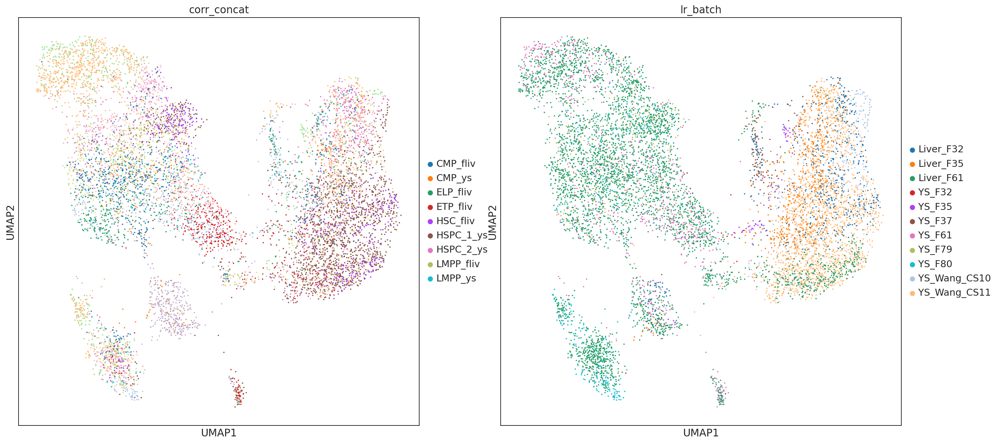

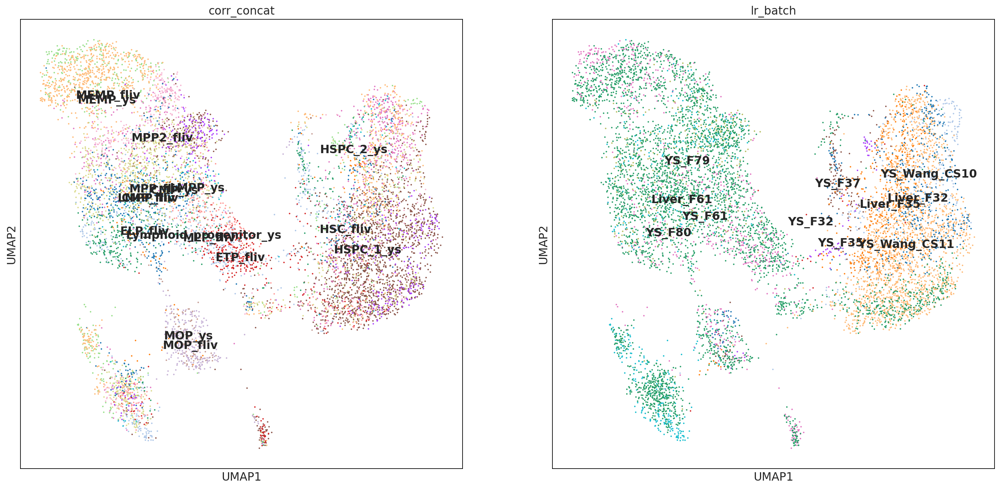

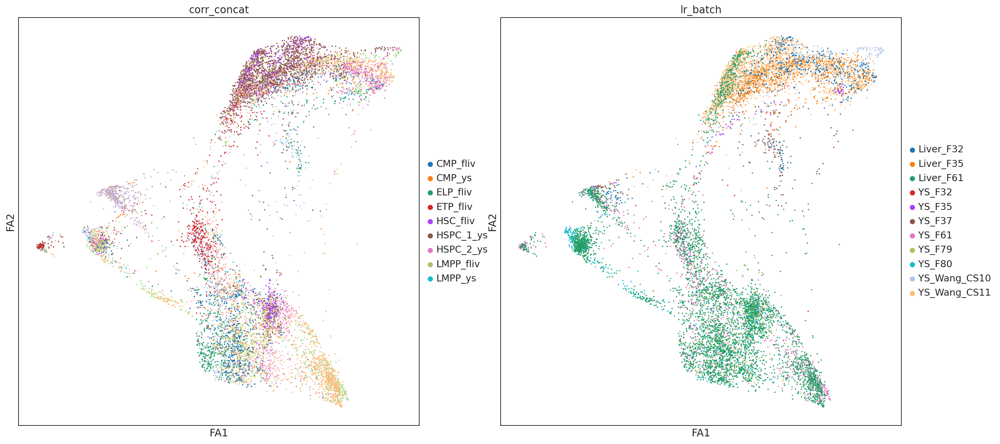

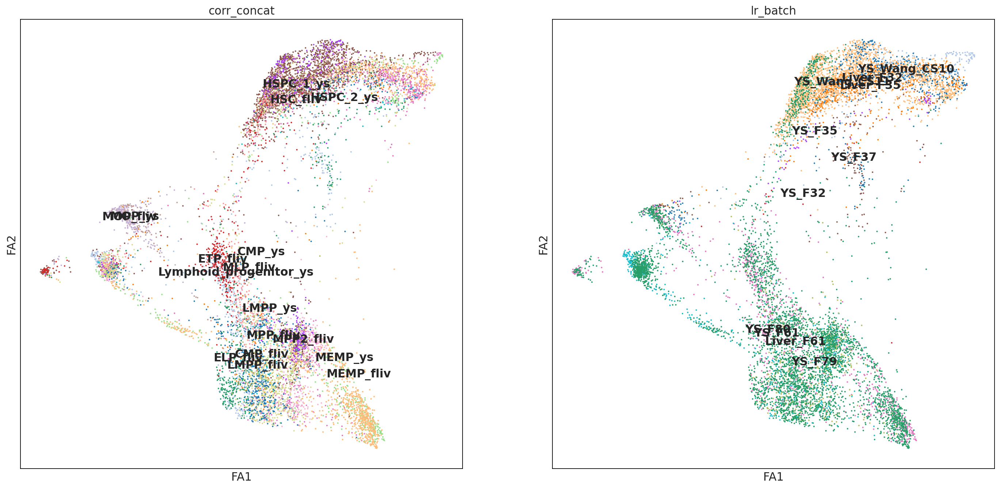

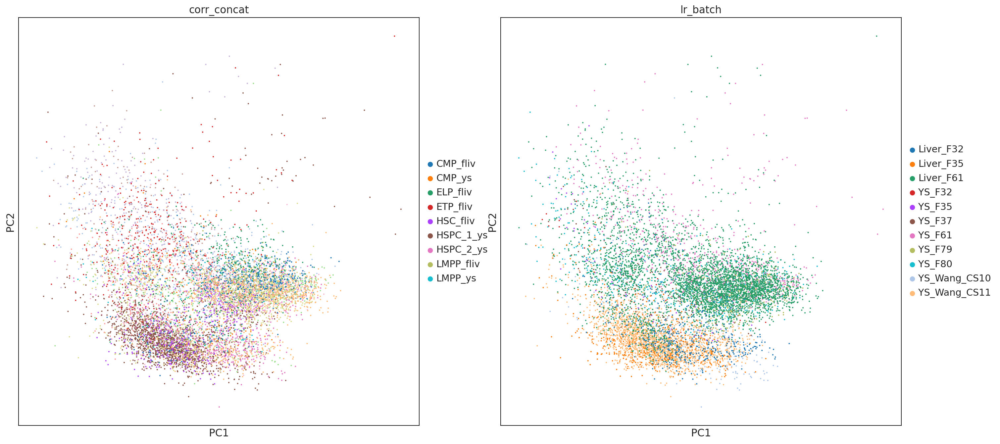

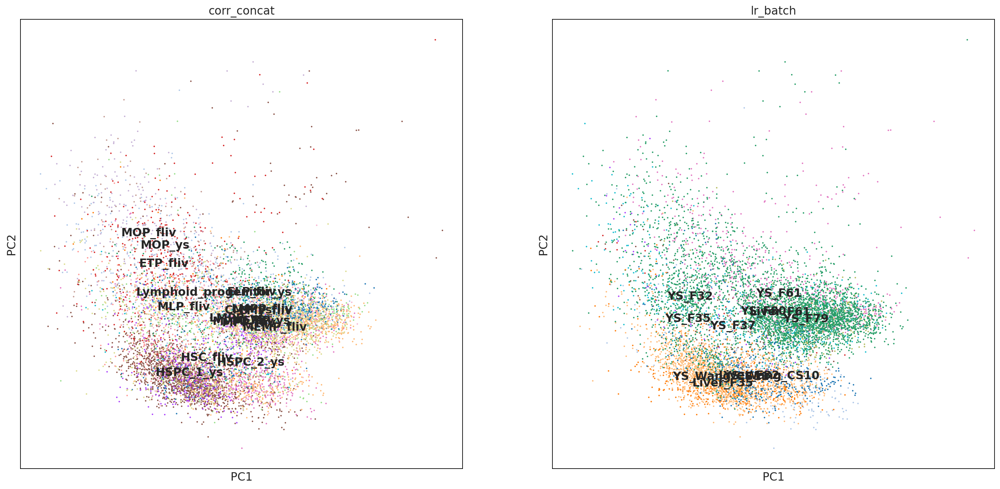

In [34]:
batch_correction = "Harmony" # Will accept Harmony, BBKNN or False as options
batch = ['lr_batch'] # Will accept any batch categorical. Comma space a batch categorical for each dataset. Position 1 is for data1, position 2 is for data2
batch = ['tissue'] # Will accept any batch categorical. Comma space a batch categorical for each dataset. Position 1 is for data1, position 2 is for data2
sc.pp.pca(adata, n_comps=50, use_highly_variable=True, svd_solver='arpack')
if(batch_correction == "Harmony"):
    print("Commencing harmony")
    # Create hm subset
    adata_hm = adata[:]
    # Set harmony variables
    data_mat = np.array(adata_hm.obsm["X_pca"])
    meta_data = adata_hm.obs
    vars_use = batch
    # Run Harmony
    ho = hm.run_harmony(data_mat, meta_data, vars_use,theta = 3)
    res = (pd.DataFrame(ho.Z_corr)).T
    res.columns = ['X{}'.format(i + 1) for i in range(res.shape[1])]
    # Insert coordinates back into object
    adata_hm.obsm["X_pca_back"]= adata_hm.obsm["X_pca"][:]
    adata_hm.obsm["X_pca"] = np.array(res)
    # Run neighbours
    sc.pp.neighbors(adata_hm, n_neighbors=15, n_pcs=50)
    sc.tl.umap(adata_hm)
    adata = adata_hm[:]
    del adata_hm
sc.tl.draw_graph(adata, layout='fa')
sc.pl.umap(adata,color = [common_cat,'lr_batch'])
sc.pl.umap(adata,color = [common_cat,'lr_batch'],legend_loc='on data')
sc.pl.draw_graph(adata,color = [common_cat,'lr_batch'])
sc.pl.draw_graph(adata,color = [common_cat,'lr_batch'],legend_loc='on data')
sc.pl.pca(adata, color=[common_cat,'lr_batch'])
sc.pl.pca(adata, color=[common_cat,'lr_batch'],legend_loc='on data')

In [94]:
adata.write(save_loc+run_name+'.h5ad')

In [89]:
#adata_orig = adata[:]
#adata = adata_orig[:]

computing neighbors
    using 'X_pca' with n_pcs = 50
    finished: added to `.uns['neighbors']`
    `.obsp['distances']`, distances for each pair of neighbors
    `.obsp['connectivities']`, weighted adjacency matrix (0:00:02)
computing UMAP
    finished: added
    'X_umap', UMAP coordinates (adata.obsm) (0:00:15)
drawing single-cell graph using layout 'fa'
    finished: added
    'X_draw_graph_fa', graph_drawing coordinates (adata.obsm) (0:02:36)


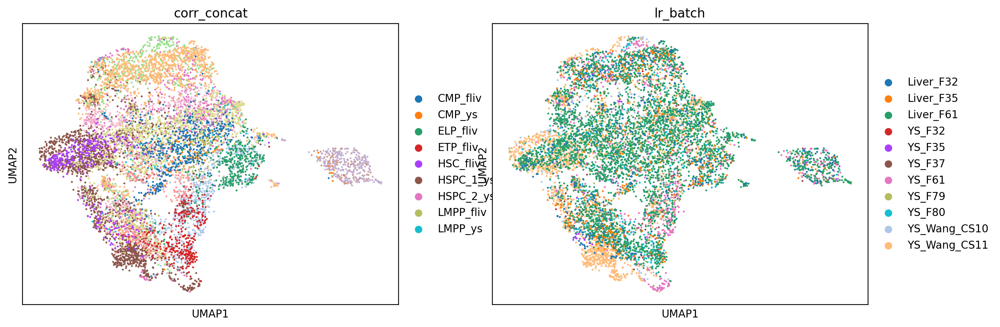

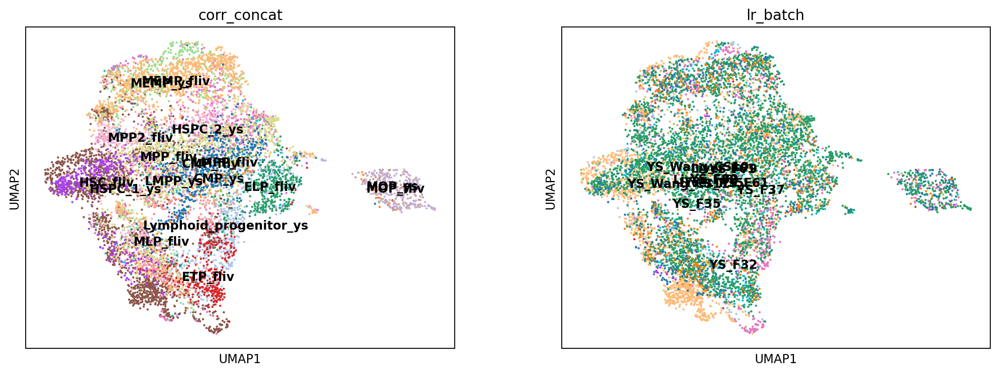

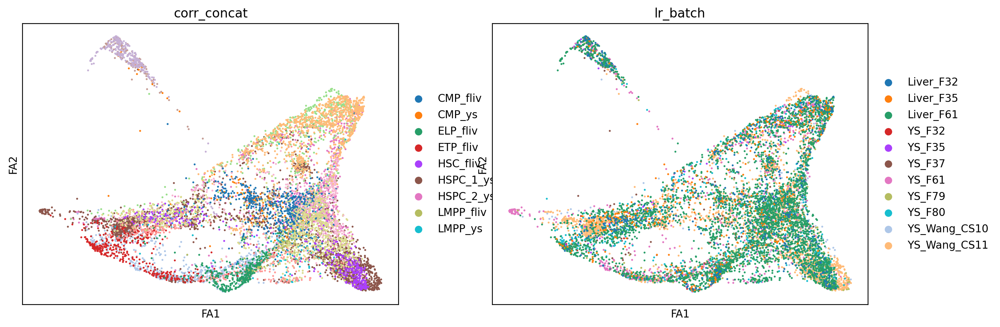

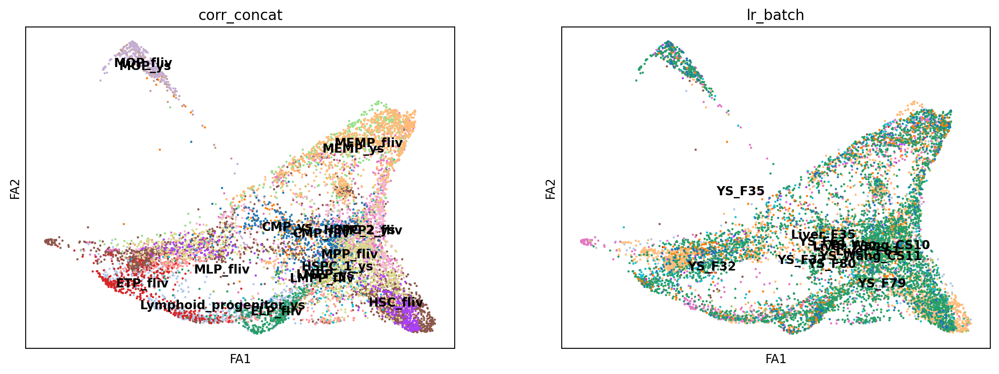

In [91]:
common_cat = 'corr_concat'
sc.pp.neighbors(adata, n_neighbors=15, n_pcs=50)
sc.tl.umap(adata)
sc.tl.draw_graph(adata, layout='fa')
sc.pl.umap(adata,color = [common_cat,'lr_batch'])
sc.pl.umap(adata,color = [common_cat,'lr_batch'],legend_loc='on data')
sc.pl.draw_graph(adata,color = [common_cat,'lr_batch'])
sc.pl.draw_graph(adata,color = [common_cat,'lr_batch'],legend_loc='on data')

In [92]:
#adata = adata_orig[:]

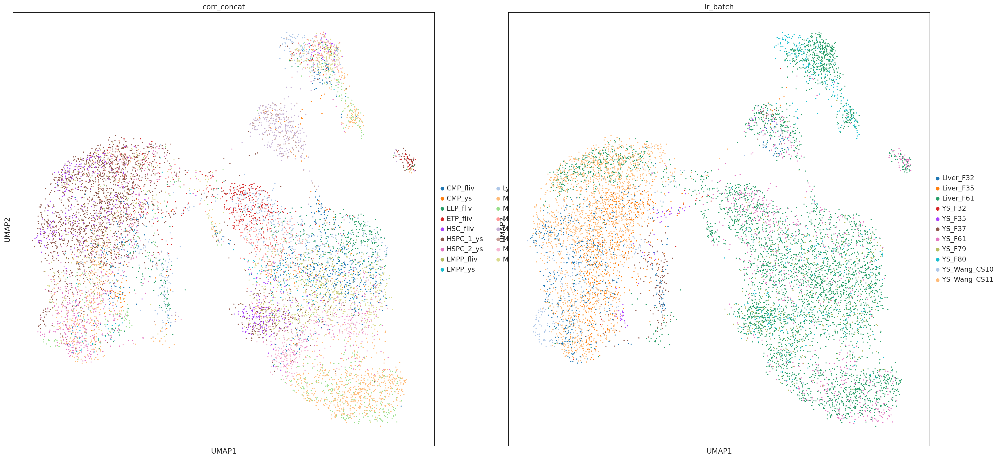

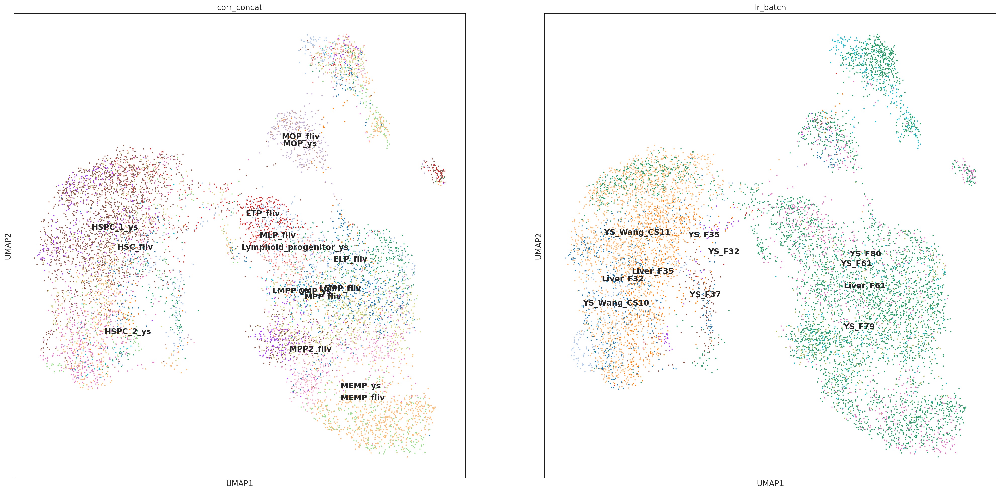

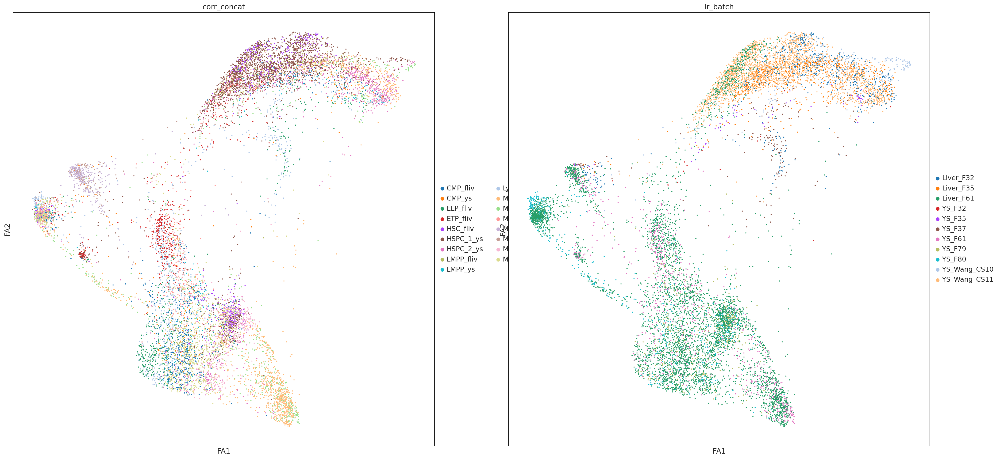

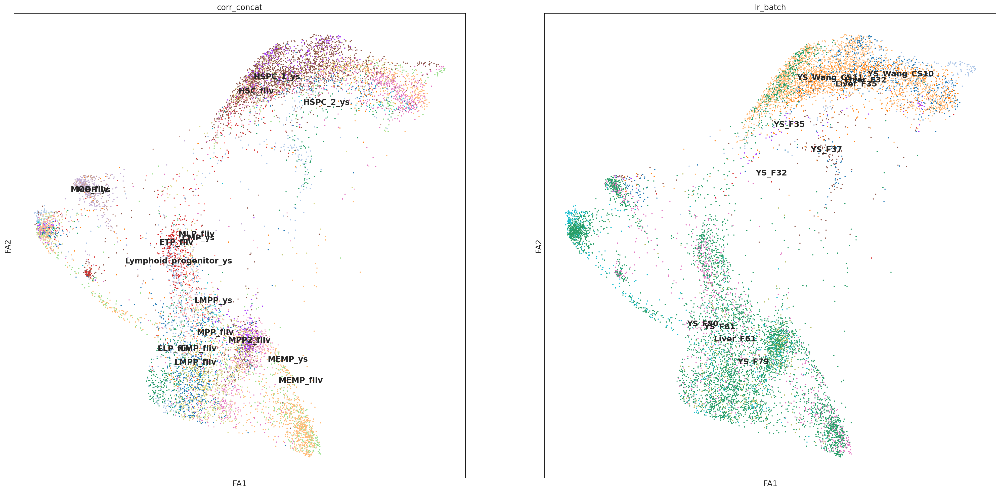

In [111]:
common_cat = 'corr_concat'
sc.pp.neighbors(adata, n_neighbors=20, n_pcs=50)
sc.tl.umap(adata)
sc.tl.draw_graph(adata, layout='fa')
sc.pl.umap(adata,color = [common_cat,'lr_batch'],size = 20)
sc.pl.umap(adata,color = [common_cat,'lr_batch'],legend_loc='on data',size = 20)
sc.pl.draw_graph(adata,color = [common_cat,'lr_batch'],size = 20)
sc.pl.draw_graph(adata,color = [common_cat,'lr_batch'],legend_loc='on data',size = 20)

In [8]:
common_cat = 'cell.labels'

In [4]:
adata = sc.read(save_loc+run_name+'.h5ad')

# No high var?

computing PCA
    with n_comps=50
    finished (0:00:29)
Commencing harmony


2021-10-07 11:04:59,109 - harmonypy - INFO - Iteration 1 of 10
2021-10-07 11:05:14,817 - harmonypy - INFO - Iteration 2 of 10
2021-10-07 11:05:27,112 - harmonypy - INFO - Iteration 3 of 10
2021-10-07 11:05:41,204 - harmonypy - INFO - Iteration 4 of 10
2021-10-07 11:05:53,305 - harmonypy - INFO - Iteration 5 of 10
2021-10-07 11:06:03,202 - harmonypy - INFO - Iteration 6 of 10
2021-10-07 11:06:14,309 - harmonypy - INFO - Iteration 7 of 10
2021-10-07 11:06:25,005 - harmonypy - INFO - Iteration 8 of 10
2021-10-07 11:06:32,587 - harmonypy - INFO - Iteration 9 of 10
2021-10-07 11:06:46,391 - harmonypy - INFO - Iteration 10 of 10
2021-10-07 11:06:53,989 - harmonypy - INFO - Stopped before convergence


computing neighbors
    using 'X_pca' with n_pcs = 50
    finished: added to `.uns['neighbors']`
    `.obsp['distances']`, distances for each pair of neighbors
    `.obsp['connectivities']`, weighted adjacency matrix (0:00:01)
computing UMAP
    finished: added
    'X_umap', UMAP coordinates (adata.obsm) (0:00:15)


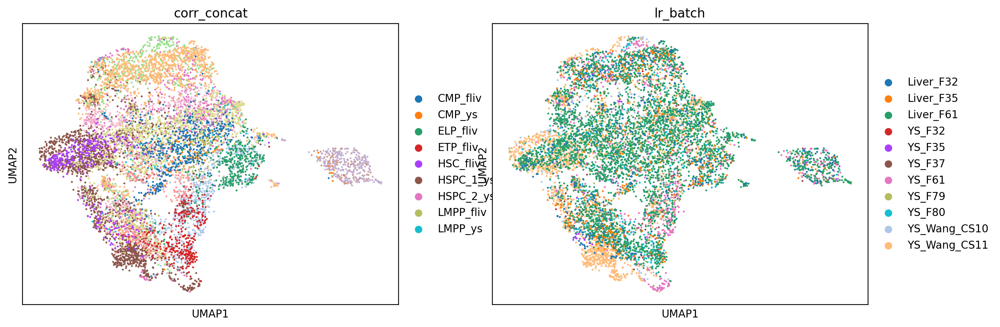

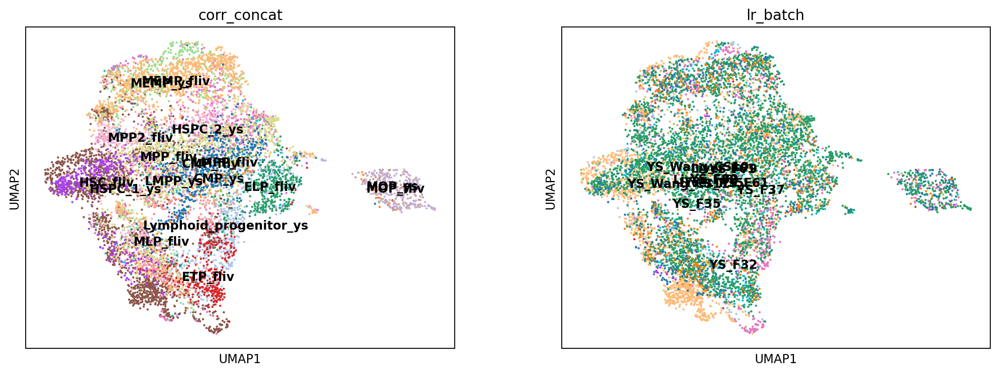

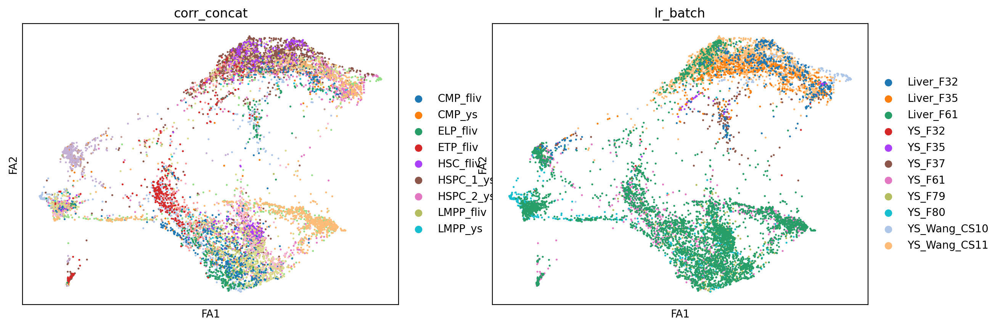

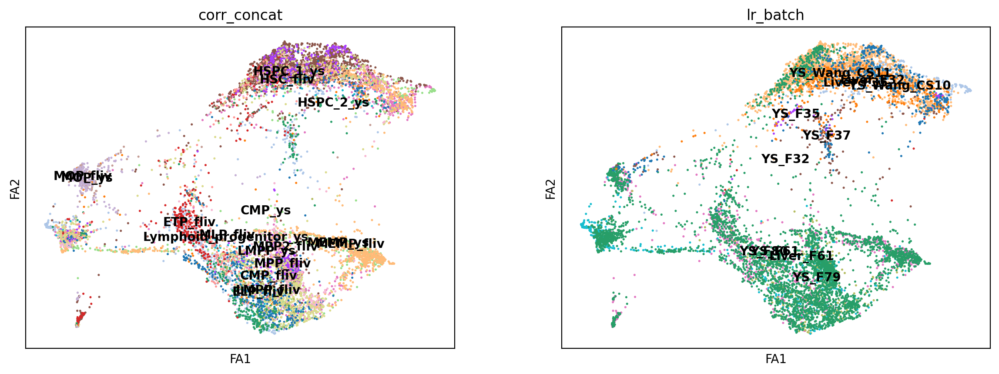

In [85]:
batch_correction = "Harmony" # Will accept Harmony, BBKNN or False as options
batch = ['lr_batch'] # Will accept any batch categorical. Comma space a batch categorical for each dataset. Position 1 is for data1, position 2 is for data2
sc.pp.pca(adata, n_comps=50, use_highly_variable=False, svd_solver='arpack')
if(batch_correction == "Harmony"):
    print("Commencing harmony")
    # Create hm subset
    adata_hm = adata[:]
    # Set harmony variables
    data_mat = np.array(adata_hm.obsm["X_pca"])
    meta_data = adata_hm.obs
    vars_use = batch
    # Run Harmony
    ho = hm.run_harmony(data_mat, meta_data, vars_use)
    res = (pd.DataFrame(ho.Z_corr)).T
    res.columns = ['X{}'.format(i + 1) for i in range(res.shape[1])]
    # Insert coordinates back into object
    adata_hm.obsm["X_pca_back"]= adata_hm.obsm["X_pca"][:]
    adata_hm.obsm["X_pca"] = np.array(res)
    # Run neighbours
    sc.pp.neighbors(adata_hm, n_neighbors=15, n_pcs=50)
    sc.tl.umap(adata_hm)
    adata = adata_hm[:]
    del adata_hm

sc.pl.umap(adata,color = [common_cat,'lr_batch'])
sc.pl.umap(adata,color = [common_cat,'lr_batch'],legend_loc='on data')
sc.pl.draw_graph(adata,color = [common_cat,'lr_batch'])
sc.pl.draw_graph(adata,color = [common_cat,'lr_batch'],legend_loc='on data')

In [11]:
adata = sc.read(save_loc+run_name+'.h5ad')

In [12]:
save_loc+run_name+'.h5ad'

'/nfs/team205/ig7/work_backups/backup_210306/projects/YS/YS_090321_notebooks/YS_Reprocess_250721_updates/FDG_FIG2/YS_fliv_progen_trajectory_with_HE_290921.h5ad'

In [13]:
#adata = adata_orig[:]

In [14]:
ys_fliv = ("/nfs/team205/ig7/work_backups/backup_210306/projects/YS/resources/ys_fliv_cell_labels_pal_traj.csv")

In [17]:
## Vars
common_cat = 'corr_concat'
adata_var = common_cat
col_pal = ys_fliv

In [18]:
#Check if all cats are indeed available
pal = pd.read_csv(col_pal)
#Uppercase everything
pal = pal.apply(lambda x: x.astype(str).str.upper())
adata.obs["var"] = adata.obs[adata_var]
var = 'var'
adata.obs['var'] = adata.obs['var'].astype(str).str.upper()

#Not in intersect
intersecting = set(list(pal["categories"])) & set(list(adata.obs['var'].unique()))
print(len(intersecting),intersecting)
print("non_intersect",set(list(pal["categories"])) ^ set(list(adata.obs['var'].unique())))

17 {'LMPP_YS', 'HSPC_1_YS', 'MEMP_FLIV', 'CMP_FLIV', 'HSPC_2_YS', 'MOP_YS', 'LMPP_FLIV', 'MLP_FLIV', 'CMP_YS', 'HSC_FLIV', 'MPP_FLIV', 'MEMP_YS', 'ELP_FLIV', 'LYMPHOID_PROGENITOR_YS', 'MOP_FLIV', 'MPP2_FLIV', 'ETP_FLIV'}
non_intersect {'PROMONOCYTE_FLIV', 'ENDOTHELIUM_FLIV', 'HEPATOCYTE_FLIV', 'EO_BASOPHIL_YS', 'PRE_PRO_B_PROGENITOR_FLIV', 'DC3_FLIV', 'NK_YS', 'PRE_B_FLIV', 'ILC_PRECURSOR_FLIV', 'PRE_PDC_FLIV', 'VWF_EC_YS', 'PRO_B_PROGENITOR_FLIV', 'DC2_YS', 'ILC_PRECURSOR_YS', 'PRE_MACROPHAGE_YS', 'PROLIF_SINUSOIDAL_EC_YS', 'MACROPHAGE_YS', 'HE_YS', 'MONOCYTE_FLIV', 'NEUTROPHIL_PRECURSOR_YS', 'MAST_CELL_YS', 'DC2_FLIV', 'IMMATURE_EC_YS', 'PDC_FLIV', 'EO_BASO_MAST_PRECURSOR_YS', 'ERYTHROID_YS', 'EARLY_ERYTHROID_YS', 'PROMONOCYTE_YS', 'MESOTHELIUM_YS', 'DC_PRECURSOR_YS', 'PROLIF_AEC_YS', 'MONOCYTE_YS', 'PRE_DC2_FLIV', 'ENDODERM_YS', 'MAST_CELL_FLIV', 'KUPFFER_CELL_1_FLIV', 'SMOOTH_MUSCLE_YS', 'IMMATURE_B_CELL_FLIV', 'ERYTHROID_FLIV', 'PRE_ILC_PRECURSOR_FLIV', 'PROMYELOCYTE_FLIV', 'FIBRO

In [19]:
print("non_intersect",set(list(pal["categories"])) ^ set(list(adata.obs['var'].unique())))

non_intersect {'PROMONOCYTE_FLIV', 'ENDOTHELIUM_FLIV', 'HEPATOCYTE_FLIV', 'EO_BASOPHIL_YS', 'PRE_PRO_B_PROGENITOR_FLIV', 'DC3_FLIV', 'NK_YS', 'PRE_B_FLIV', 'ILC_PRECURSOR_FLIV', 'PRE_PDC_FLIV', 'VWF_EC_YS', 'PRO_B_PROGENITOR_FLIV', 'DC2_YS', 'ILC_PRECURSOR_YS', 'PRE_MACROPHAGE_YS', 'PROLIF_SINUSOIDAL_EC_YS', 'MACROPHAGE_YS', 'HE_YS', 'MONOCYTE_FLIV', 'NEUTROPHIL_PRECURSOR_YS', 'MAST_CELL_YS', 'DC2_FLIV', 'IMMATURE_EC_YS', 'PDC_FLIV', 'EO_BASO_MAST_PRECURSOR_YS', 'ERYTHROID_YS', 'EARLY_ERYTHROID_YS', 'PROMONOCYTE_YS', 'MESOTHELIUM_YS', 'DC_PRECURSOR_YS', 'PROLIF_AEC_YS', 'MONOCYTE_YS', 'PRE_DC2_FLIV', 'ENDODERM_YS', 'MAST_CELL_FLIV', 'KUPFFER_CELL_1_FLIV', 'SMOOTH_MUSCLE_YS', 'IMMATURE_B_CELL_FLIV', 'ERYTHROID_FLIV', 'PRE_ILC_PRECURSOR_FLIV', 'PROMYELOCYTE_FLIV', 'FIBROBLAST_YS', 'EMBRYONIC_ERYTHROID_FLIV', 'AEC_YS', 'SINUSOIDAL_EC_YS', 'MICROGLIA_YS', 'KUPFFER_CELL_2_FLIV', 'EARLY_ERYTHROID_FLIV', 'MK_FLIV', 'FIBROBLAST_FLIV', 'MONOCYTE_MACROPHAGE_YS', 'DC1_FLIV', 'MK_YS', 'EO_BASOPHIL

In [20]:
adata.obs['var'].unique()

array(['MEMP_YS', 'HSPC_1_YS', 'LYMPHOID_PROGENITOR_YS', 'HSPC_2_YS',
       'MOP_YS', 'CMP_YS', 'LMPP_YS', 'MPP_FLIV', 'MEMP_FLIV', 'MLP_FLIV',
       'HSC_FLIV', 'CMP_FLIV', 'MOP_FLIV', 'ELP_FLIV', 'MPP2_FLIV',
       'ETP_FLIV', 'LMPP_FLIV'], dtype=object)

# Minor Corrections

In [21]:
print("non_intersect",set(list(pal["categories"])) ^ set(list(adata.obs['var'].unique())))

non_intersect {'PROMONOCYTE_FLIV', 'ENDOTHELIUM_FLIV', 'HEPATOCYTE_FLIV', 'EO_BASOPHIL_YS', 'PRE_PRO_B_PROGENITOR_FLIV', 'DC3_FLIV', 'NK_YS', 'PRE_B_FLIV', 'ILC_PRECURSOR_FLIV', 'PRE_PDC_FLIV', 'VWF_EC_YS', 'PRO_B_PROGENITOR_FLIV', 'DC2_YS', 'ILC_PRECURSOR_YS', 'PRE_MACROPHAGE_YS', 'PROLIF_SINUSOIDAL_EC_YS', 'MACROPHAGE_YS', 'HE_YS', 'MONOCYTE_FLIV', 'NEUTROPHIL_PRECURSOR_YS', 'MAST_CELL_YS', 'DC2_FLIV', 'IMMATURE_EC_YS', 'PDC_FLIV', 'EO_BASO_MAST_PRECURSOR_YS', 'ERYTHROID_YS', 'EARLY_ERYTHROID_YS', 'PROMONOCYTE_YS', 'MESOTHELIUM_YS', 'DC_PRECURSOR_YS', 'PROLIF_AEC_YS', 'MONOCYTE_YS', 'PRE_DC2_FLIV', 'ENDODERM_YS', 'MAST_CELL_FLIV', 'KUPFFER_CELL_1_FLIV', 'SMOOTH_MUSCLE_YS', 'IMMATURE_B_CELL_FLIV', 'ERYTHROID_FLIV', 'PRE_ILC_PRECURSOR_FLIV', 'PROMYELOCYTE_FLIV', 'FIBROBLAST_YS', 'EMBRYONIC_ERYTHROID_FLIV', 'AEC_YS', 'SINUSOIDAL_EC_YS', 'MICROGLIA_YS', 'KUPFFER_CELL_2_FLIV', 'EARLY_ERYTHROID_FLIV', 'MK_FLIV', 'FIBROBLAST_FLIV', 'MONOCYTE_MACROPHAGE_YS', 'DC1_FLIV', 'MK_YS', 'EO_BASOPHIL

/home/jovyan/my-conda-envs/workhorse/lib/python3.8/site-packages/anndata/_core/anndata.py:1220: FutureWarning: The `inplace` parameter in pandas.Categorical.reorder_categories is deprecated and will be removed in a future version. Removing unused categories will always return a new Categorical object.
  c.reorder_categories(natsorted(c.categories), inplace=True)
... storing 'var' as categorical


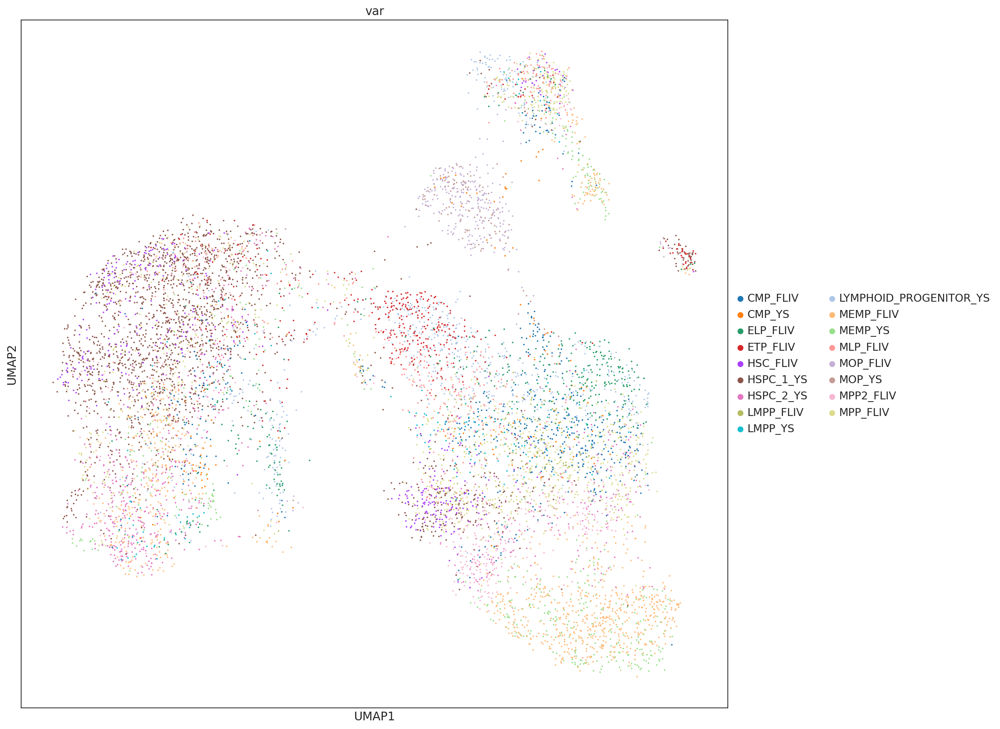

In [22]:
sc.pl.umap(adata, color = "var")

In [23]:
list(adata.obs['var']).sort()

# Create mappable field

In [24]:
cells = list(adata.obs['var'].unique())
cells.sort()
col = list(range(0,len(cells)))
pal = pal.set_index('categories')
pal = pal.loc[cells]
col_pal = list(pal["color"])

In [25]:
adata.obs.columns

Index(['cell.labels', 'stage', 'lanes', 'sex', 'sort.ids', 'fetal.ids',
       'component', 'broad_cell.labels', 'sequencing.type', 'orig.dataset',
       'broad_cell_labels_organ', 'tissue', 'corr_concat', 'lr_batch', 'var'],
      dtype='object')

In [26]:
col_pal

['#4E6379',
 '#67839C',
 '#E4E4FF',
 '#FEE4D4',
 '#8BA1B4',
 '#AFBFCC',
 '#E17AC1',
 '#5A1D29',
 '#7A2839',
 '#FFFF99',
 '#92553D',
 '#B87056',
 '#FFFF3C',
 '#6F045F',
 '#AB0890',
 '#A50000',
 '#AFAF00']

In [29]:
sc.settings.set_figure_params(dpi=300, color_map='viridis')
plt.rcParams['figure.figsize'] = [10, 10]

/home/jovyan/my-conda-envs/workhorse/lib/python3.8/site-packages/anndata/_core/anndata.py:1220: FutureWarning: The `inplace` parameter in pandas.Categorical.reorder_categories is deprecated and will be removed in a future version. Removing unused categories will always return a new Categorical object.
  c.reorder_categories(natsorted(c.categories), inplace=True)
... storing 'num' as categorical
/home/jovyan/my-conda-envs/workhorse/lib/python3.8/site-packages/anndata/_core/anndata.py:1220: FutureWarning: The `inplace` parameter in pandas.Categorical.reorder_categories is deprecated and will be removed in a future version. Removing unused categories will always return a new Categorical object.
  c.reorder_categories(natsorted(c.categories), inplace=True)
... storing 'var_num' as categorical


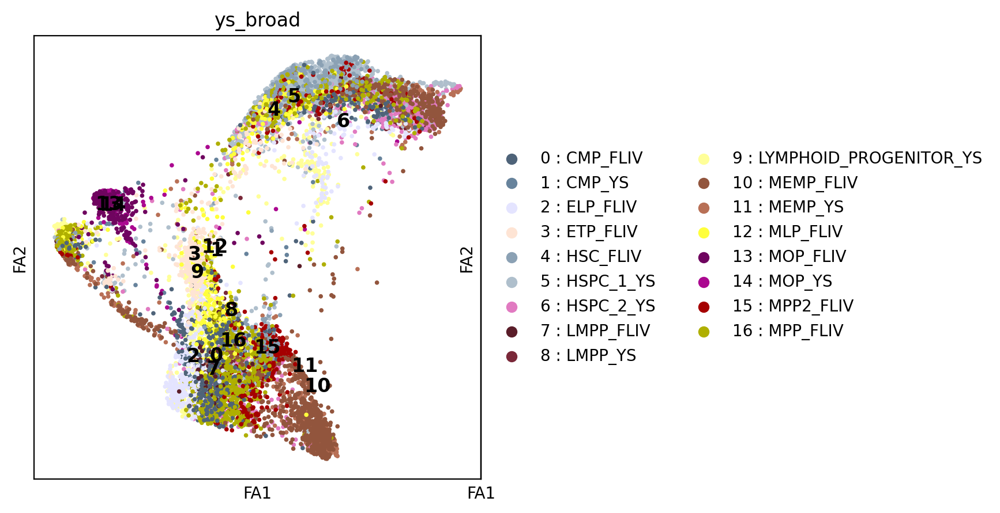

In [32]:
dic = dict(zip(cells,col))

#Create a mappable field
adata.obs['num'] = adata.obs[var]
#map to adata.obs.col to create a caterorical column
adata.obs['num'] = adata.obs['num'].map(dic)

##Map to a pallete to use with umap
#cells_list = pd.DataFrame(adata.obs["cell.labels"].cat.categories)
#cells_list['col'] = cells_list[0].map(dic)
#col_pal = list(cells_list['col'])
adata.obs['num'] = adata.obs['num'].astype(str)
adata.obs[var+'_num'] = adata.obs['num'].astype(str) + " : " + adata.obs[var].astype(str)

import matplotlib
matplotlib.rcdefaults() #Reset matplot lb deafults as seaborne tends to mess with this
fig, (ax1, ax2,) = plt.subplots(1,2, figsize=(5,5), gridspec_kw={'wspace':0,'width_ratios': [1,0]})
p2 = sc.pl.draw_graph(adata, color = (var+'_num') ,ax=ax2,show=False,size=10,title="", palette= col_pal) #title=i
p3 = sc.pl.draw_graph(adata, color = "num",legend_loc="on data",size=30,legend_fontsize='large',ax=ax1,show=False,title="ys_broad", palette= col_pal) #title=i

fig.savefig('./'+var+"FLIV_YS_combined_HEAM_TRAJ_num.pdf",bbox_inches='tight')

/home/jovyan/my-conda-envs/workhorse/lib/python3.8/site-packages/anndata/_core/anndata.py:1220: FutureWarning: The `inplace` parameter in pandas.Categorical.reorder_categories is deprecated and will be removed in a future version. Removing unused categories will always return a new Categorical object.
  c.reorder_categories(natsorted(c.categories), inplace=True)
... storing 'num' as categorical
/home/jovyan/my-conda-envs/workhorse/lib/python3.8/site-packages/anndata/_core/anndata.py:1220: FutureWarning: The `inplace` parameter in pandas.Categorical.reorder_categories is deprecated and will be removed in a future version. Removing unused categories will always return a new Categorical object.
  c.reorder_categories(natsorted(c.categories), inplace=True)
... storing 'var_num' as categorical


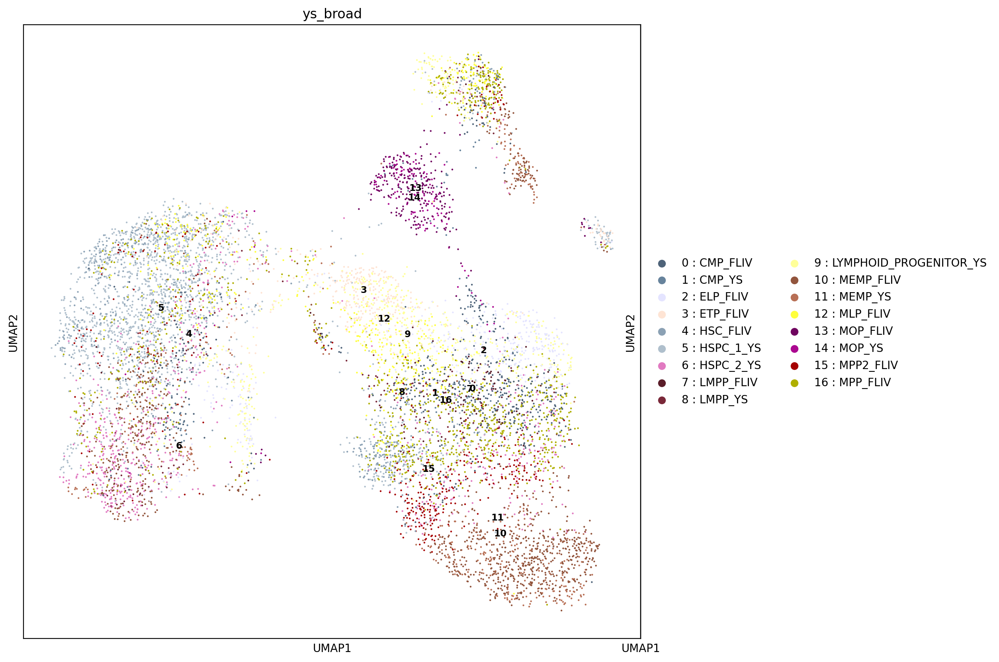

In [28]:
dic = dict(zip(cells,col))

#Create a mappable field
adata.obs['num'] = adata.obs[var]
#map to adata.obs.col to create a caterorical column
adata.obs['num'] = adata.obs['num'].map(dic)

##Map to a pallete to use with umap
#cells_list = pd.DataFrame(adata.obs["cell.labels"].cat.categories)
#cells_list['col'] = cells_list[0].map(dic)
#col_pal = list(cells_list['col'])
adata.obs['num'] = adata.obs['num'].astype(str)
adata.obs[var+'_num'] = adata.obs['num'].astype(str) + " : " + adata.obs[var].astype(str)

import matplotlib
matplotlib.rcdefaults() #Reset matplot lb deafults as seaborne tends to mess with this
fig, (ax1, ax2,) = plt.subplots(1,2, figsize=(10,10), gridspec_kw={'wspace':0,'width_ratios': [1,0]})
p2 = sc.pl.umap(adata, color = (var+'_num') ,ax=ax2,show=False,size=5,title="", palette= col_pal) #title=i
p3 = sc.pl.umap(adata, color = "num",legend_loc="on data",size=10,legend_fontsize='small',ax=ax1,show=False,title="ys_broad", palette= col_pal) #title=i

fig.savefig('./'+var+"FLIV_YS_combined_HEAM_num.pdf",bbox_inches='tight')